## Imports

In [1]:
import numpy as np
import cv2 as cv
import glob
import math
import random
from matplotlib import pyplot as plt
from skspatial.objects import Plane, Points
from skspatial.plotting import plot_3d
from sympy import Matrix, init_printing

## Helpers

### Drawing

In [2]:
# plot images in a grid
def plot_grid(images, rows, columns, figsize=30):
    display_columns = 4
    fig, axes = plt.subplots(rows, columns, figsize=(figsize,figsize))

    for img, ax in zip(images, axes.ravel()):
        ax.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
        ax.axis('off')
    fig.tight_layout()

# plot images in a row
def plot_row(images, figsize=30):
    fig, axes = plt.subplots(1, len(images), figsize=(figsize,figsize))

    for img, ax in zip(images, axes.ravel()):
        ax.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
        ax.axis('off')
    fig.tight_layout()

# plot a single image
def plot_img(image, figsize=10):
    fig, ax = plt.subplots(1, 1, figsize=(figsize,figsize))
    ax.imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))
    ax.axis('off')
    fig.tight_layout()

# draw axis in a image
def draw_axis(img, corners, imgpts):
    imgCopy = np.copy(img)
    corner = tuple(corners[0].ravel().astype(int))
    imgCopy = cv.line(imgCopy, corner, tuple(imgpts[0].ravel().astype(int)), (255,0,0), 5)
    imgCopy = cv.line(imgCopy, corner, tuple(imgpts[1].ravel().astype(int)), (0,255,0), 5)
    imgCopy = cv.line(imgCopy, corner, tuple(imgpts[2].ravel().astype(int)), (0,0,255), 5)
    return imgCopy    

# draw input lines on an img
def draw_lines(img, lines, no_bg=True):
    imgCopy = np.copy(img)
    if no_bg:
        imgCopy = imgCopy * 0
    for line in lines:
        x1, y1, x2, y2 = line[0]
        cv.line(imgCopy, (x1, y1), (x2, y2), (random.random() * 255,random.random() * 255,random.random() * 255),2)
    return imgCopy

### Line detection

In [3]:
# undistort an image
def undistort_img(img, mtx, dist):
    h, w = img.shape[:2]
    newcameramtx, roi = cv.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
    newimg = cv.undistort(img, mtx, dist, None, newcameramtx)
    return newimg

# detect edges from an image using Canny
def edge_detection(img):
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY) # convert to gray color
    filtered = cv.bilateralFilter(gray, 30, 50, 50) # blur
    edges = cv.Canny(filtered, 20, 30) # edge detection
    return [gray, filtered, edges]

# enhance shadow edges from an img
def edge_enhancement(img):
    kernel = np.ones((3,3), np.uint8)
    closing = cv.morphologyEx(img, cv.MORPH_CLOSE, kernel, iterations=7) # closing to close small features
    erosion = cv.erode(closing, kernel, iterations=5) # erode to have a finer edge
    return erosion

# detect lines from an image using HoughLinesP
def hough_line_detection(img):
    rho = 1  # distance resolution in pixels of the Hough grid
    theta = np.pi / 180  # angular resolution in radians of the Hough grid
    threshold = 100  # minimum number of votes (intersections in Hough grid cell)
    min_line_length = 100  # minimum number of pixels making up a line
    max_line_gap = 50  # maximum gap in pixels between connectable line segments
    upper_layer = 100 # lines above this layer will not be considered
    lower_layer = 1100 # lines below this layer will not be considered

    # "lines" is an array containing endpoints of detected line segments
    lines = cv.HoughLinesP(img, rho, theta, threshold, np.array([]), min_line_length, max_line_gap)

    # filter lines from top and bottom image edges, due to setup
    new_lines = []
    for line in lines:
        for x1,y1,x2,y2 in line:
            # image is 1200x800, ignore undistort-induced edges
            if not y1 > lower_layer and not y1 < upper_layer:
                new_lines.append(line)
    return new_lines

#-------------------------# 
#   HOUGH LINES BUNDLER   #
#-------------------------#
class HoughBundler:
    # Based on: https://stackoverflow.com/questions/45531074/how-to-merge-lines-after-houghlinesp
    # Class that clusters similar/overlapped Hough Lines and merges them

    def get_slope(self, line):
        # https://en.wikipedia.org/wiki/Atan2
        slope = math.atan2(abs((line[0] - line[2])), abs((line[1] - line[3])))
        return math.degrees(slope)

    def is_different_line(self, line_new, groups, min_distance_to_merge, min_angle_to_merge):
        for group in groups:
            for line_old in group:
                if self.get_distance_between_lines(line_old, line_new) < min_distance_to_merge:
                    slope_new = self.get_slope(line_new)
                    slope_old = self.get_slope(line_old)
                    if abs(slope_new - slope_old) < min_angle_to_merge:
                        group.append(line_new)
                        return False
        return True

    def point_to_line_dist(self, point, line):
        # http://local.wasp.uwa.edu.au/~pbourke/geometry/pointline/source.vba
        px, py = point
        x1, y1, x2, y2 = line

        def get_line_length(x1, y1, x2, y2):
            line_length = math.sqrt(math.pow((x2 - x1), 2) + math.pow((y2 - y1), 2))
            return line_length

        line_length = get_line_length(x1, y1, x2, y2)
        if line_length < 0.00000001:
            point_to_line_dist = 9999
            return point_to_line_dist

        u1 = (((px - x1) * (x2 - x1)) + ((py - y1) * (y2 - y1)))
        u = u1 / (line_length * line_length)

        if (u < 0.00001) or (u > 1):
            # closest point does not fall within the line segment, take the shorter distance to an endpoint
            ix = get_line_length(px, py, x1, y1)
            iy = get_line_length(px, py, x2, y2)
            if ix > iy:
                point_to_line_dist = iy
            else:
                point_to_line_dist = ix
        else:
            # intersecting point is on the line, use the formula
            ix = x1 + u * (x2 - x1)
            iy = y1 + u * (y2 - y1)
            point_to_line_dist = get_line_length(px, py, ix, iy)

        return point_to_line_dist

    def get_distance_between_lines(self, line1, line2):
        dist1 = self.point_to_line_dist(line1[:2], line2)
        dist2 = self.point_to_line_dist(line1[2:], line2)
        dist3 = self.point_to_line_dist(line2[:2], line1)
        dist4 = self.point_to_line_dist(line2[2:], line1)

        return min(dist1, dist2, dist3, dist4)

    def merge_lines_pipeline(self, lines):
        groups = []  # all lines groups are here

        # Parameters to play with
        min_distance_to_merge = 10
        min_angle_to_merge = 30

        def getFirstPointX(line):
            return line[0]
        lines = sorted(lines, key=getFirstPointX)

        # first line will create a new group every time
        groups.append([lines[0]])

        # if line is different from existing groups, create a new group
        for line_new in lines[1:]:
            if self.is_different_line(line_new, groups, min_distance_to_merge, min_angle_to_merge):
                groups.append([line_new])

        return groups

    def merge_lines_segments(self, lines):
        # Sort lines cluster and return first and last coordinates
        slope = self.get_slope(lines[0])

        # special case
        if(len(lines) == 1):
            return [lines[0][:2], lines[0][2:]]

        # [[1,2,3,4],[]] to [[1,2],[3,4],[],[]]
        points = []
        for line in lines:
            points.append(line[:2])
            points.append(line[2:])
        # if vertical
        if not 45 < slope < 135:
            #sort by y
            points = sorted(points, key=lambda point: point[1])
        else:
            #sort by x
            points = sorted(points, key=lambda point: point[0])

        # return first and last point in sorted group
        # [[x,y],[x,y]]
        return [points[0], points[-1]]
        

    # convert bundler line format to the hough lines format
    def convert_line_format(self, bundled_lines):
        newlines = []
        for line in bundled_lines:
            x2, y2, x1, y1 = line[0][0], line[0][1], line[1][0], line[1][1]
            if x2 < x1:
                x1, y1, x2, y2 = x2, y2, x1, y1
            newlines.append(np.array([[x1,y1,x2,y2]], dtype=np.int32))

        def getFirstPointX(line):
            return line[0][0]
        newlines = sorted(newlines, key=getFirstPointX)

        return newlines

    def process_lines(self, lines):
        lines_x = []
        lines_y = []
        # for every line of cv.HoughLinesP()
        for line_i in [l[0] for l in lines]:
                slope = self.get_slope(line_i)
                # if vertical
                if 45 < slope < 135:
                    lines_y.append(line_i)
                else:
                    lines_x.append(line_i)

        lines_y = sorted(lines_y, key=lambda line: line[1])
        lines_x = sorted(lines_x, key=lambda line: line[0])
        merged_lines_all = []

        # for each cluster in vertical and horizontal lines leave only one line
        for i in [lines_x, lines_y]:
                if len(i) > 0:
                    groups = self.merge_lines_pipeline(i)
                    merged_lines = []
                    for group in groups:
                        merged_lines.append(self.merge_lines_segments(group))

                    merged_lines_all.extend(merged_lines)

        return self.convert_line_format(merged_lines_all)

### 3D calculation

In [4]:
# 3D -> 2D
def world_to_image(projMtx, x, y, z):
    res = np.dot(projMtx, [[x],[y],[z],[1]])
    return res/res[2]

# 2D -> 3D
def image_to_world(matrix, i, j):
    res = np.linalg.solve(matrix, [[i], [j], [1], [0]])
    [[x], [y], [z], [_]] = res/res[3]
    return [x, y, z]

## Images

In [5]:
# Images used for the camera Intrinsic calibration
intrinsic_calib_imgs = glob.glob('images/calib/*.jpg')

# Image used for the camera Extrinsic calibration
extrinsic_calib_img = cv.imread('images/exp2/chess.jpg')

# Image used to calibrate the shadow plane
OBJ_HEIGHT = 5.56 # known height of the object in the image
shadow_plane_calib_img = cv.imread('images/exp2/calib.jpg')

# Image with object to calculate 3D coordinates
original_image = cv.imread('images/exp2/test4.jpg')

## Intrinsic parameters
### Preparation

In [6]:
# pattern size
pattern = ((9,6))

# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((pattern[0] * pattern[1], 3), np.float32)
objp[:,:2] = np.mgrid[0:pattern[0],0:pattern[1]].T.reshape(-1,2) * 2.5

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

### Camera calibration

Intrinsic Matrix:


Matrix([
[976.650843614879,              0.0, 612.269639785328],
[             0.0, 976.630548727191, 396.648776222763],
[             0.0,              0.0,              1.0]])

Distortion factors:


Matrix([[-0.186640301912597, 0.135313741466237, -0.00104640490610282, 0.000973106307639385, 0.047369144507465]])

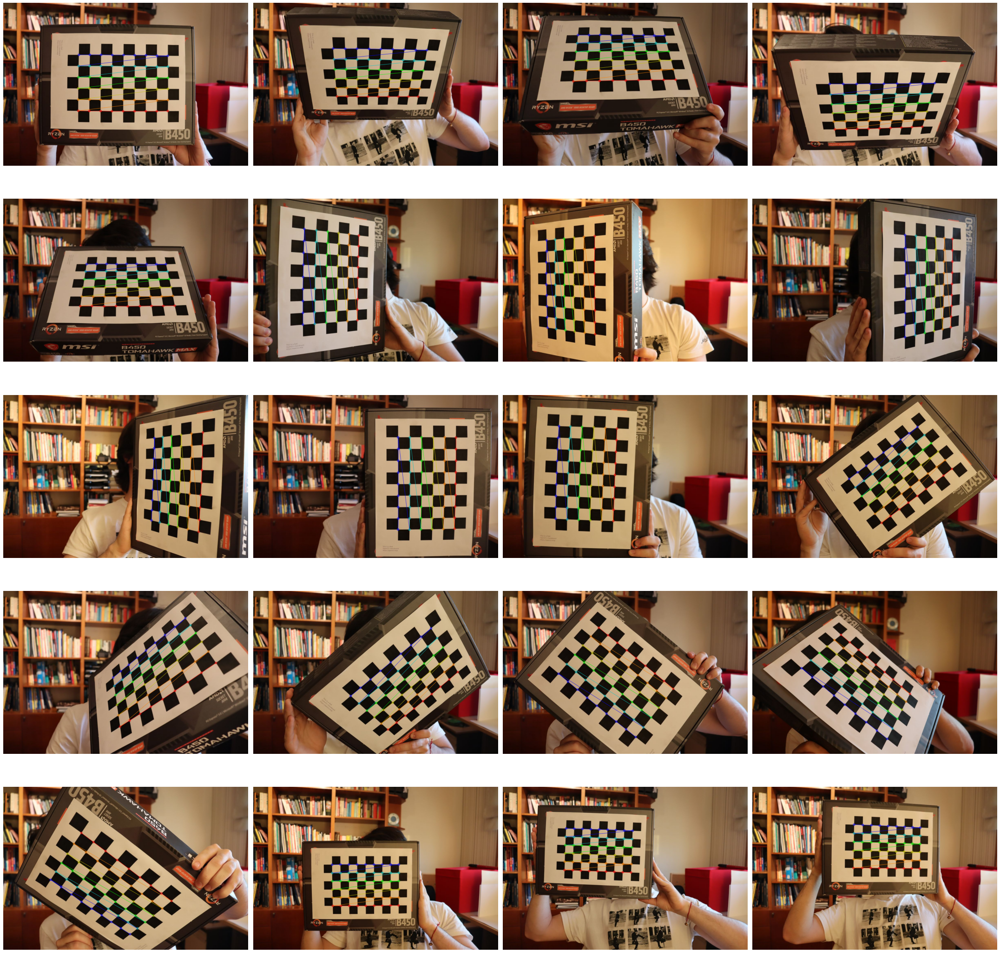

In [7]:
display_images = []
for i, fname in enumerate(intrinsic_calib_imgs): # go through all images
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY) # convert to graycolor
    
    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, pattern, None)

    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)

        corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)

        # Draw and display the corners
        cv.drawChessboardCorners(img, pattern, corners2, ret)
        display_images.append(img)

# calibrate the camera
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
print("Intrinsic Matrix:")
display(Matrix(mtx))
print("Distortion factors:")
display(Matrix(dist))

# plot images
display_columns = 4
plot_grid(display_images, math.ceil(len(intrinsic_calib_imgs)/display_columns), display_columns)

### Reprojection error (with rvecs and tvecs from calibrateCamera)

In [9]:
mean_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv.norm(imgpoints[i], imgpoints2, cv.NORM_L2)/len(imgpoints2)
    mean_error += error
print( "total error: {}".format(mean_error/len(objpoints)) )

total error: 0.037547841205804414


## Extrinsic parameters
### Preparation

In [10]:
# pattern size
pattern = ((9,6))

# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)
objp = np.zeros((pattern[0]*pattern[1],3), np.float32)
objp[:,:2] = np.mgrid[0:pattern[0],0:pattern[1]].T.reshape(-1,2) * 2.5
axis = np.float32([[3,0,0], [0,3,0], [0,0,-3]]).reshape(-1,3)

### Calculate pose

In [11]:
grayextrinsicCalibImage = cv.cvtColor(extrinsic_calib_img, cv.COLOR_BGR2GRAY) # convert to graycolor
ret, corners = cv.findChessboardCorners(grayextrinsicCalibImage, pattern, None)
if ret != True:
    print("Failed to calibrate extrinsic parameters")
    exit()
corners2 = cv.cornerSubPix(grayextrinsicCalibImage, corners, (11,11), (-1,-1), criteria)  
ret, rvecs, tvecs, _ = cv.solvePnPRansac(objp, corners2, mtx, dist)

rmtx, _ = cv.Rodrigues(rvecs)

print("Rotation Matrix:")
display(Matrix(cv.Rodrigues(rvecs)[0]))
print("Translation Vector:")
display(Matrix(tvecs))

Rotation Matrix:


Matrix([
[   0.999850302575456, 0.00214815331765221, 0.0171685141201028],
[-0.00836389990279036,   0.928635261745463,  0.370899711271594],
[  -0.015146538158418,  -0.370987784273633,  0.928514214377764]])

Translation Vector:


Matrix([
[-11.0020162605463],
[-6.86861118640009],
[ 39.2418273710595]])

Reprojection Error: 0.06140661003065938px


### Draw axis

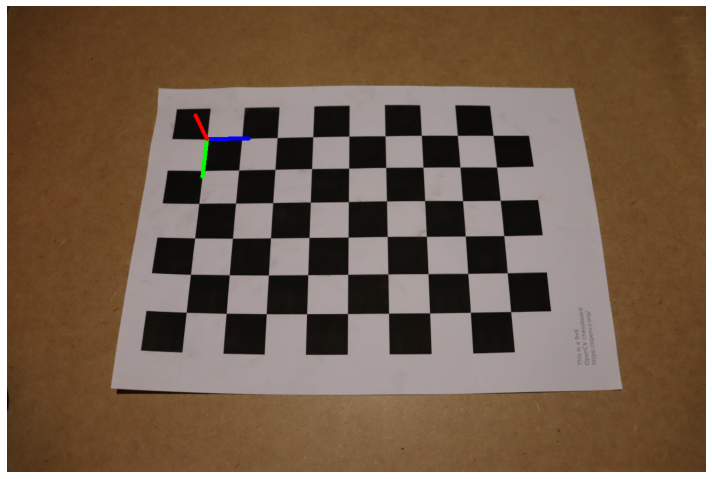

In [12]:
imgpts, jac = cv.projectPoints(axis, rvecs, tvecs, mtx, dist)
axisimg = draw_axis(extrinsic_calib_img, corners2, imgpts)

plot_img(axisimg, figsize=10)

## Shadow plane calibration

### Undistort

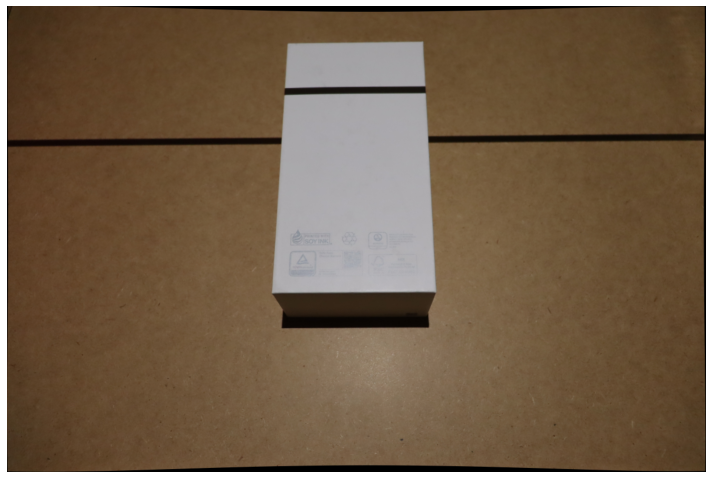

In [13]:
img = undistort_img(shadow_plane_calib_img, mtx, dist)
plot_img(img, figsize=10)

### Referential

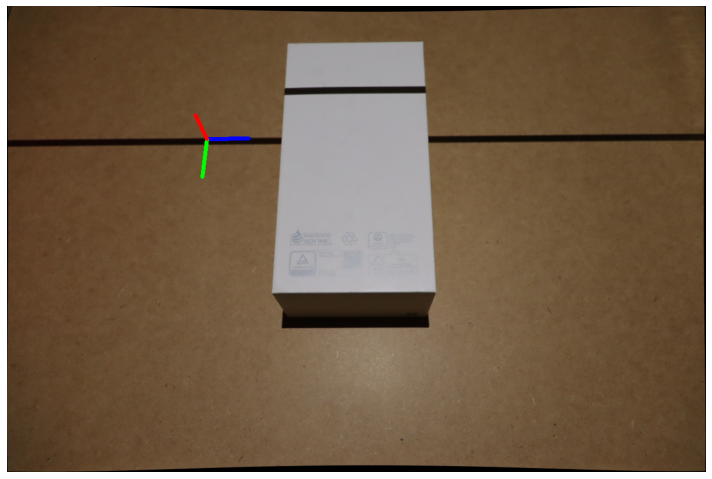

In [14]:
imgpts, jac = cv.projectPoints(axis, rvecs, tvecs, mtx, dist)
axisimg = draw_axis(img, corners2, imgpts)

plot_img(axisimg, figsize=10)

### Edge detection

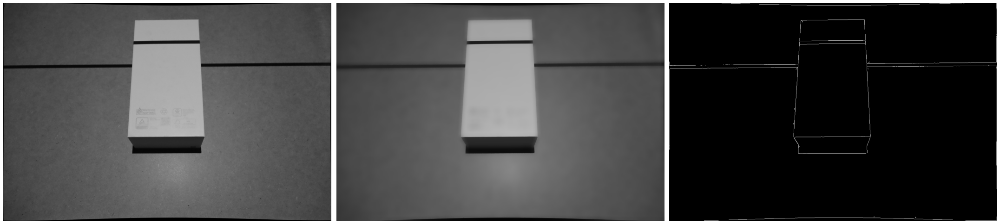

In [15]:
gray, filtered, edges = edge_detection(img) # detect edges
plot_row([gray, filtered, edges])

### Edge enhancement

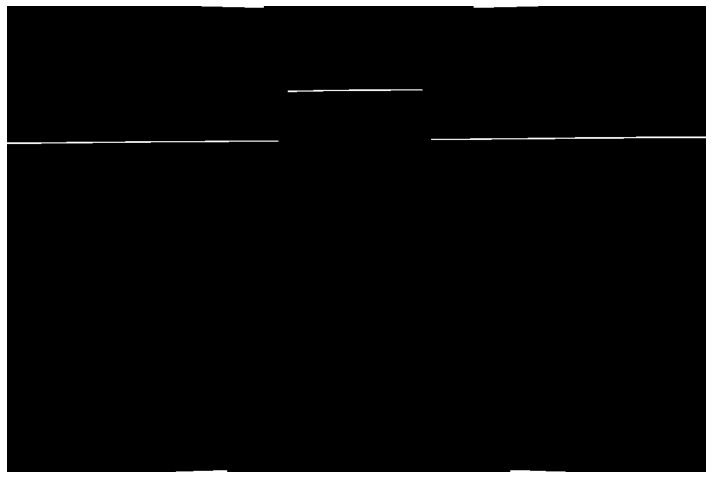

In [16]:
enhanced = edge_enhancement(edges) # enhance shadow edges
plot_img(enhanced, figsize=10)

### Hough detection

Number of lines: 12
[[ 762  229 1105  224]]
[[102 233 380 233]]
[[  0 234 246 234]]
[[203 232 465 232]]
[[ 896  228 1182  224]]
[[482 147 711 143]]
[[482 146 654 143]]
[[1015  227 1199  224]]
[[  0 235 146 235]]
[[340 231 465 231]]
[[728 229 990 225]]
[[597 145 712 143]]


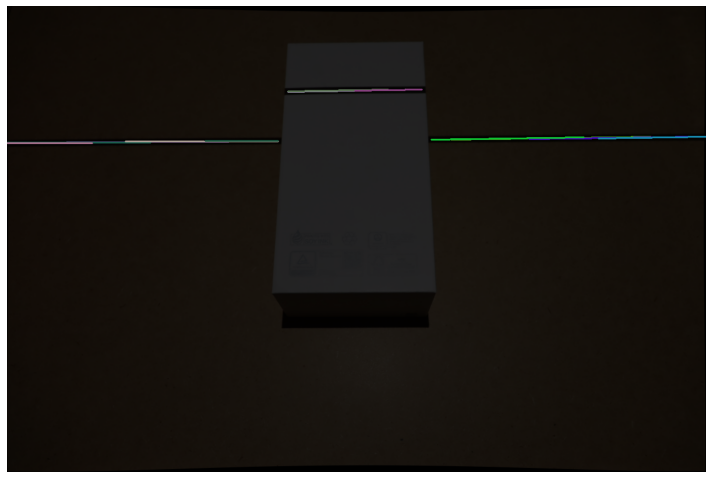

In [17]:
# line detection
lines = hough_line_detection(enhanced)

# draw
imgLines = draw_lines(img, lines)
imgLines = cv.addWeighted(img, 0.2, imgLines, 0.8, 0)
plot_img(imgLines, figsize=10)
# output
print(f'Number of lines: {len(lines)}')
for line in lines:
    print(line)

### Bundle line segments

Number of lines: 3
[[  0 234 465 231]]
[[482 146 712 143]]
[[ 728  229 1199  224]]


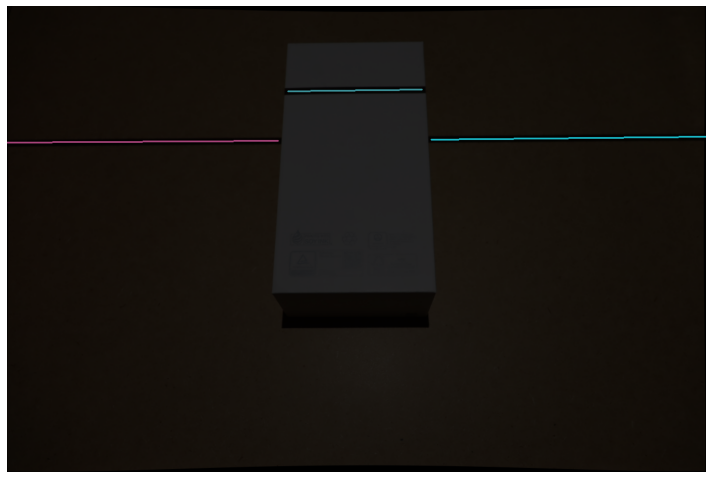

In [18]:
# merge lines
bundled_lines = HoughBundler().process_lines(lines)

# draw
imgBundled = draw_lines(img, bundled_lines)
imgBundled = cv.addWeighted(img, 0.2, imgBundled, 0.8, 0)
plot_img(imgBundled, figsize=10)

# output
print(f'Number of lines: {len(bundled_lines)}')
for line in bundled_lines:
    print(line)

### Projection matrix

In [19]:
# calculate projection matrix (projMtx) -> 3D to 2D
rmtx, _ = cv.Rodrigues(rvecs)
rotTransMtx = np.zeros((3,4))
rotTransMtx[:,:-1] = rmtx
rotTransMtx[:,-1:] = tvecs

projMtx = np.dot(mtx, rotTransMtx)

print("Projection Matrix:")
display(Matrix(projMtx))

Projection Matrix:


Matrix([
[  967.230876036662,  -225.046561292075,  585.268707371642, 13281.4510466694],
[ -14.1762959761093,   759.781714620159,  730.526015380314, 8857.12729150804],
[-0.015146538158418, -0.370987784273633, 0.928514214377764, 39.2418273710595]])

### Calculate image points

In [20]:
# initialize list to hold image coordinates of points in the shadow line
img_points_shadow = []
# initialize list to hold world coordinates of points in the shadow line
obj_points_shadow = []

# lines on the left and right are on the plane z = 0
inverseMtxFloor = np.zeros((4,4))
inverseMtxFloor[:-1,:] = projMtx
inverseMtxFloor[-1:,:] = [[0, 0, 1, 0]]

print("Floor Projection Matrix:")
display(Matrix(inverseMtxFloor))

# right line
[[i1, j1, i2, j2]] = bundled_lines[2]
img_points_shadow.append([i1, j1])
obj_points_shadow.append(image_to_world(inverseMtxFloor, i1, j1))
img_points_shadow.append([i2, j2])
obj_points_shadow.append(image_to_world(inverseMtxFloor, i2, j2))

# left line
[[i1, j1, i2, j2]] = bundled_lines[0]
img_points_shadow.append([i1, j1])
obj_points_shadow.append(image_to_world(inverseMtxFloor, i1, j1))
img_points_shadow.append([i2, j2])
obj_points_shadow.append(image_to_world(inverseMtxFloor, i2, j2))

# the center line is on the plane z = OBJ_HEIGHT
inverseMtxObj = np.zeros((4,4))
inverseMtxObj[:-1,:] = projMtx
inverseMtxObj[-1:,:] = [[0, 0, 1, OBJ_HEIGHT]]

print("Box Projection Matrix:")
display(Matrix(inverseMtxObj))

[[i1, j1, i2, j2]] = bundled_lines[1]
img_points_shadow.append([i1, j1])
obj_points_shadow.append(image_to_world(inverseMtxObj, i1, j1))
img_points_shadow.append([i2, j2])
obj_points_shadow.append(image_to_world(inverseMtxObj, i2, j2))

# output list of non-coplanar points that are in the shadow line
print(obj_points_shadow)

Floor Projection Matrix:


Matrix([
[  967.230876036662,  -225.046561292075,  585.268707371642, 13281.4510466694],
[ -14.1762959761093,   759.781714620159,  730.526015380314, 8857.12729150804],
[-0.015146538158418, -0.370987784273633, 0.928514214377764, 39.2418273710595],
[               0.0,                0.0,               1.0,              0.0]])

Box Projection Matrix:


Matrix([
[  967.230876036662,  -225.046561292075,  585.268707371642, 13281.4510466694],
[ -14.1762959761093,   759.781714620159,  730.526015380314, 8857.12729150804],
[-0.015146538158418, -0.370987784273633, 0.928514214377764, 39.2418273710595],
[               0.0,                0.0,               1.0,             5.56]])

[[15.610202237163977, 0.35087941197277467, 0.0], [34.19029466203606, 0.35797627073102256, -6.573367283157719e-15], [-13.68194949291242, 0.21260957055151122, 0.0], [5.1138591349178135, 0.3102827003674252, 0.0], [6.581178572181746, 0.31810049582168465, -5.560000000000003], [14.544707610187004, 0.3107926166181779, -5.560000000000002]]


### Shadow plane equation

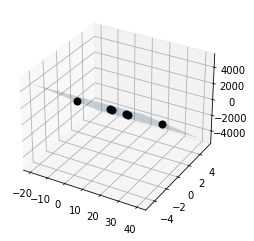

In [21]:
# calculate shadow plane equation
plane_points = Points(obj_points_shadow)
plane = Plane.best_fit(plane_points)

# plot the plane and the points
plot_3d(
     plane_points.plotter(c='k', s=50, depthshade=False),
     plane.plotter(alpha=0.2, lims_x=(-30, 30), lims_y=(-5, 5)),
)

# calculate final matrix for 2D -> 3D conversion, now with the shadow plane's equations
final_shadow_plane = plane.cartesian()
inverseMtxFinal = np.zeros((4,4))
inverseMtxFinal[:-1,:] = projMtx
inverseMtxFinal[-1:,:] = [final_shadow_plane]

### Calculate error

In [22]:
# test if the final matrix is able to correctly calculate the 3D coordinates of points on the shadow line

# calculate distance between the expected point and the calculated point
def calc_error(expected, calculated):
    return np.sqrt(np.sum((np.array(expected) - np.array(calculated)) ** 2, axis=0))

# for the previously collected points, calculate world coordinates and check the error
for idx in range(len(img_points_shadow)):
    i, j = img_points_shadow[idx]
    expected = obj_points_shadow[idx]
    calculated = image_to_world(inverseMtxFinal, i, j)
    
    print(f'Image: ({i}, {j})')
    print(f'Expected: ({expected[0]}, {expected[1]}, {expected[2]})')
    print(f'Calculated: ({calculated[0]}, {calculated[1]}, {calculated[2]})')
    print(f'Error: {calc_error(expected, calculated)}')
    print('--')

Image: (728, 229)
Expected: (15.610202237163977, 0.35087941197277467, 0.0)
Calculated: (15.615576388781598, 0.32368549744105424, 0.04446696664929231)
Error: 0.05239944289929972
--
Image: (1199, 224)
Expected: (34.19029466203606, 0.35797627073102256, -6.573367283157719e-15)
Calculated: (34.16720557617043, 0.3789752144696824, -0.03434889746009522)
Error: 0.046410217420018975
--
Image: (0, 234)
Expected: (-13.68194949291242, 0.21260957055151122, 0.0)
Calculated: (-13.652701315986132, 0.23667183933589106, -0.0390839432485716)
Error: 0.054424289176990985
--
Image: (465, 231)
Expected: (5.1138591349178135, 0.3102827003674252, 0.0)
Calculated: (5.108306631641252, 0.2924325553726648, 0.02913083191414082)
Error: 0.03461305154100287
--
Image: (482, 146)
Expected: (6.581178572181746, 0.31810049582168465, -5.560000000000003)
Calculated: (6.57744840296291, 0.30256436651645113, -5.53882063355952)
Error: 0.02653019108507064
--
Image: (712, 143)
Expected: (14.544707610187004, 0.3107926166181779, -5.56

## Line detection

### Undistort

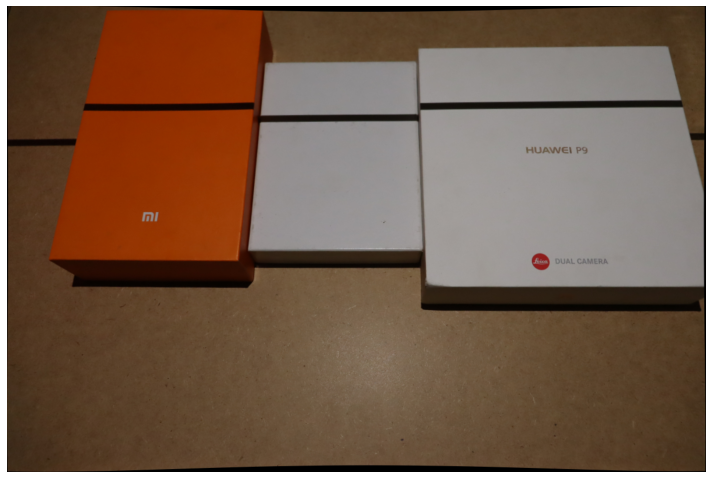

In [23]:
img = undistort_img(original_image, mtx, dist)
plot_img(img, figsize=10)

### Referential

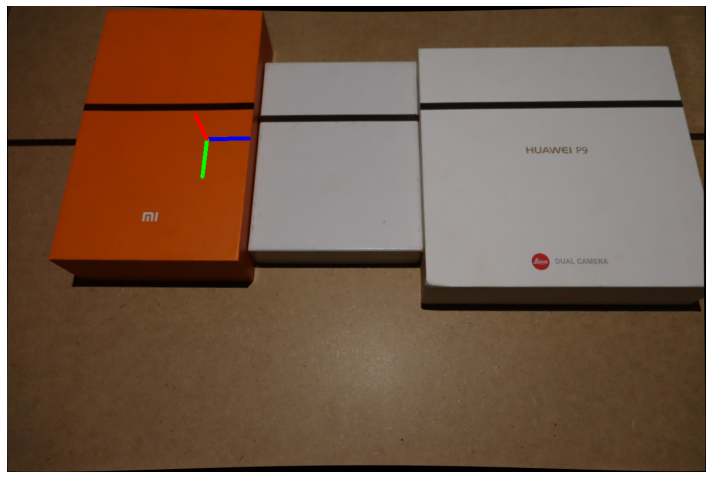

In [24]:
imgpts, jac = cv.projectPoints(axis, rvecs, tvecs, mtx, dist)
axisimg = draw_axis(img, corners2, imgpts)

plot_img(axisimg, figsize=10)

### Edge detection

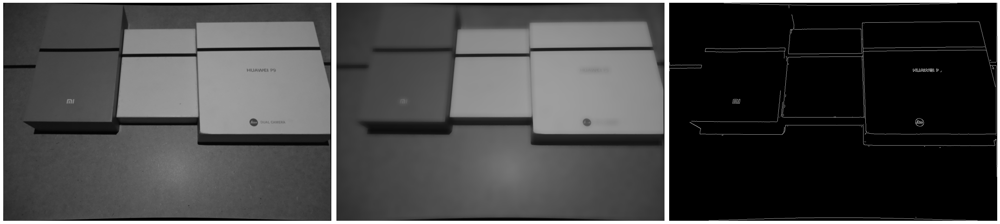

In [25]:
gray, filtered, edges = edge_detection(img) # detect edges
plot_row([gray, filtered, edges])

### Edge enhancement

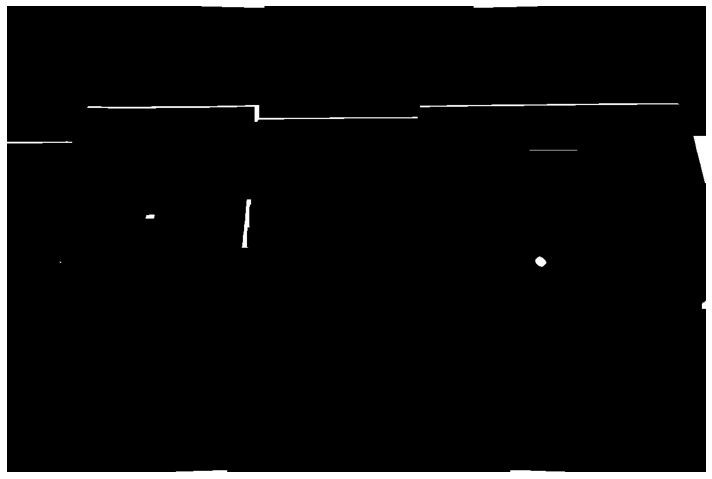

In [26]:
enhanced = edge_enhancement(edges) # enhance shadow edges
plot_img(enhanced, figsize=10)

### Hough detection

Number of lines: 11
[[ 709  173 1068  167]]
[[425 192 704 192]]
[[173 175 432 171]]
[[138 174 290 172]]
[[709 172 954 168]]
[[ 783  172 1102  167]]
[[ 875  171 1151  167]]
[[554 191 704 191]]
[[425 193 578 193]]
[[  0 233 111 233]]
[[  0 234 111 234]]


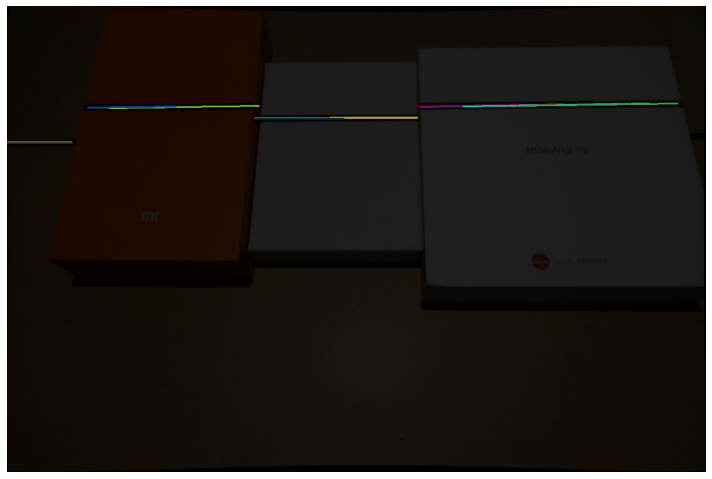

In [27]:
# line detection
lines = hough_line_detection(enhanced)

# draw
imgLines = draw_lines(img, lines)
imgLines = cv.addWeighted(img, 0.2, imgLines, 0.8, 0)
plot_img(imgLines, figsize=10)

# output
print(f'Number of lines: {len(lines)}')
for line in lines:
    print(line)

### Bundle line segments

Number of lines: 4
[[  0 233 111 234]]
[[138 174 432 171]]
[[425 192 704 191]]
[[ 709  172 1151  167]]


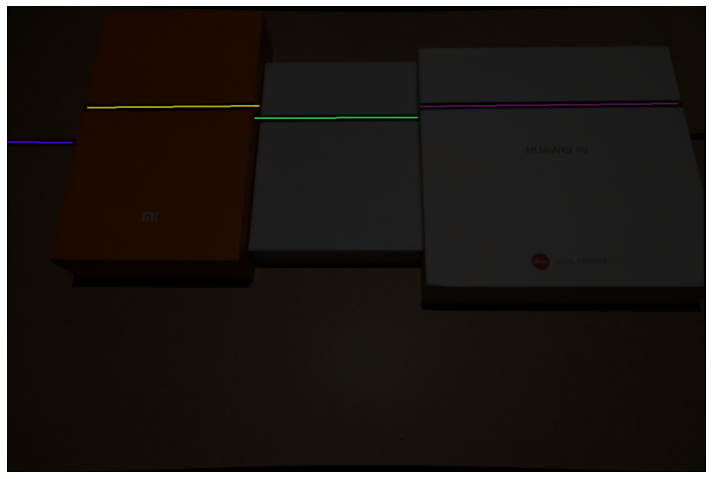

In [28]:
# merge lines
bundled_lines = HoughBundler().process_lines(lines)

# draw
imgBundled = draw_lines(img, bundled_lines) 
imgBundled = cv.addWeighted(img, 0.2, imgBundled, 0.8, 0)
plot_img(imgBundled, figsize=10)

# output
print(f'Number of lines: {len(bundled_lines)}')
for line in bundled_lines:
    print(line)

## Calculation of 3D coordinates

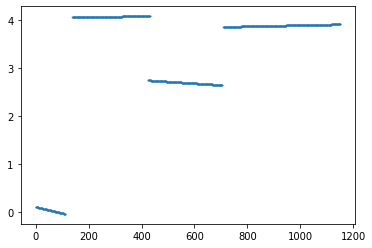

In [29]:
# given a line, return a list with all points from x1 to x2 separated by 1 unit
def get_line_points(line):
    [[x1, y1, x2, y2]] = line

    # line equation
    slope = (y2 - y1) / (x2 - x1)
    b = y1 - x1 * slope

    # calculate coordinates for all points in the line
    pnts = []
    for i in range(x1, x2 + 1):
        j = i * slope + b
        pnts.append([i, j])
    return pnts


# calculate height of shadow line points
pixel_hor = []
pnt_height = []
for line in bundled_lines:
    for i, j in get_line_points(line):
        [_, _, h] = image_to_world(inverseMtxFinal, i, j)
        pixel_hor.append(i)
        # negative of the calculated height, because in the coordinate system the height is negative
        pnt_height.append(-h)

# display height of all pixels on the line with scatterplot
plt.scatter(pixel_hor, pnt_height, s=0.5)
plt.show()

### Image points

Line 1: 
p1: (-13.61,0.24,0.11)
p2: (-11.39,0.24,0.08)
p3: (-9.18,0.25,-0.03)

Line 2: 
p4: (-6.15,0.26,4.07)
p5: (-0.77,0.28,4.11)
p6: (4.56,0.3,4.09)

Line 3: 
p7: (4.05,0.29,2.75)
p8: (9.25,0.31,2.74)
p9: (14.47,0.32,2.65)

Line 4: 
p10: (14.57,0.32,3.87)
p11: (22.5,0.35,3.92)
p12: (30.38,0.37,3.92)



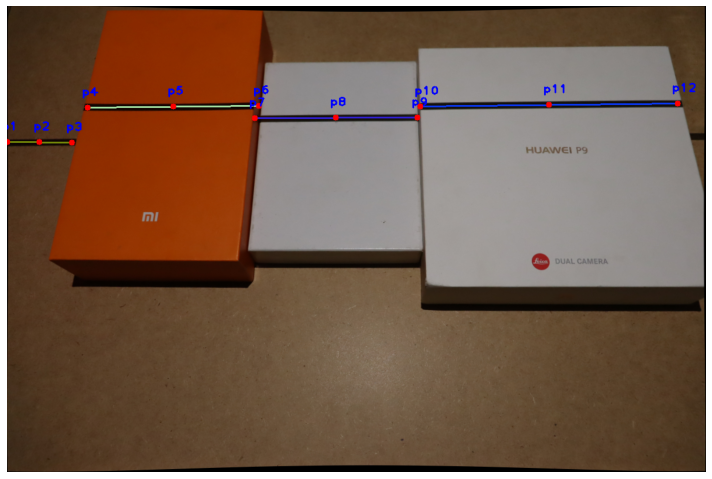

In [30]:
# draw the detected lines in the original image
imgLines = draw_lines(img, bundled_lines, no_bg=False)

# configuration of the text to appear in the image
font = cv.FONT_HERSHEY_PLAIN
fontScale = 1.4
text_color = (255, 0, 0)
text_thickness = 2
text_offset = (-100, 30)

# configuration of the points to appear in the image
radius = 5
point_thickness = cv.FILLED # negative to fill
point_color = (0, 0, 255)

# function to draw a point in the image
def draw_point(img, i, j, img_caption, print_caption, offset=text_offset):
    [x, y, z] = image_to_world(inverseMtxFinal, i, j)
    z = -z # invert z coordinate as explained, in order to have positive value
    cv.putText(img, f"{img_caption}", (i+offset[0], j+offset[1]), font, fontScale, text_color, text_thickness)
    print(f"{print_caption}({round(x,2)},{round(y,2)},{round(z,2)})")
    cv.circle(img, (i,j), radius, point_color, point_thickness)

# function to draw 3 points of a line, endpoints and middle
def draw_line_points(img, line, start_point_id, line_id, offset=text_offset):
    start_point_id += 1
    
    [[i1, j1, i2, j2]] = line
    print(f"Line {line_id}: ")
    draw_point(img, i1, j1, f"p{start_point_id}",f"p{start_point_id}: ", offset)
    draw_point(img, int((i1+i2)/2), int((j1+j2)/2), f"p{start_point_id+1}", f"p{start_point_id+1}: ", offset)
    draw_point(img, i2, j2, f"p{start_point_id+2}", f"p{start_point_id+2}: ", offset)
    print()

# draw
for i in range(len(bundled_lines)):
    draw_line_points(imgLines, bundled_lines[i], i*3, i+1, (-10, -20))

plot_img(imgLines, figsize=10)